<a href="https://colab.research.google.com/github/lakshaygola/Anomaly-Detection/blob/main/Anomaly_Detection_Simple_And_LSTM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Jovian Commit Essentials
# Please retain and execute this cell without modifying the contents for `jovian.commit` to work
!pip install jovian --upgrade -q
import jovian
jovian.set_project('anomaly-detection')
jovian.set_colab_id('1Xdm5dfOmkd_jvDjCoTrdCKjy97tuh47U')

     |████████████████████████████████| 71kB 10.2MB/s 


In [ ]:
!pip install jovian --upgrade --quiet
!pip install opendatasets --upgrade --quiet

In [ ]:
# Project name (to commit changes)
project_name = 'anomaly-detection'

In [ ]:
# Libaries we need in the project
import opendatasets as od
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mlt
import plotly.express as px
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, LabelEncoder
from sklearn.metrics import accuracy_score, confusion_matrix, recall_score 
from sklearn.metrics import classification_report, f1_score, precision_score
from sklearn.metrics import ConfusionMatrixDisplay
import tensorflow as tf
from keras.models import Sequential
from keras.layers import Dense, Dropout, LSTM, BatchNormalization
from keras.wrappers.scikit_learn import KerasClassifier

# Getting the dataset from the internet

In [ ]:
# Downloading the whole dataset (from kaggle)
datasetLink = 'https://www.kaggle.com/galaxyh/kdd-cup-1999-data'

od.download(datasetLink)

Please provide your Kaggle credentials to download this dataset. Learn more: http://bit.ly/kaggle-creds
Your Kaggle username: lakshaygola
Your Kaggle Key: ··········


 13%|█▎        | 11.0M/87.8M [00:00<00:00, 89.4MB/s]

100%|██████████| 87.8M/87.8M [00:00<00:00, 146MB/s]


In [ ]:
# Opening the file (This file contain all the feature name)
with open('/content/kdd-cup-1999-data/kddcup.names', 'r') as f:
  print(f.read())

back,buffer_overflow,ftp_write,guess_passwd,imap,ipsweep,land,loadmodule,multihop,neptune,nmap,normal,perl,phf,pod,portsweep,rootkit,satan,smurf,spy,teardrop,warezclient,warezmaster.
duration: continuous.
protocol_type: symbolic.
service: symbolic.
flag: symbolic.
src_bytes: continuous.
dst_bytes: continuous.
land: symbolic.
wrong_fragment: continuous.
urgent: continuous.
hot: continuous.
num_failed_logins: continuous.
logged_in: symbolic.
num_compromised: continuous.
root_shell: continuous.
su_attempted: continuous.
num_root: continuous.
num_file_creations: continuous.
num_shells: continuous.
num_access_files: continuous.
num_outbound_cmds: continuous.
is_host_login: symbolic.
is_guest_login: symbolic.
count: continuous.
srv_count: continuous.
serror_rate: continuous.
srv_serror_rate: continuous.
rerror_rate: continuous.
srv_rerror_rate: continuous.
same_srv_rate: continuous.
diff_srv_rate: continuous.
srv_diff_host_rate: continuous.
dst_host_count: continuous.
dst_host_srv_count: con

In [ ]:
# List of all the feature 
features=['duration',
'protocol_type',
'service',
'flag',
'src_bytes',
'dst_bytes',
'land',
'wrong_fragment',
'urgent',
'hot',
'num_failed_logins',
'logged_in',
'num_compromised',
'root_shell',
'su_attempted',
'num_root',
'num_file_creations',
'num_shells',
'num_access_files',
'num_outbound_cmds',
'is_host_login',
'is_guest_login',
'count',
'srv_count',
'serror_rate',
'srv_serror_rate',
'rerror_rate',
'srv_rerror_rate',
'same_srv_rate',
'diff_srv_rate',
'srv_diff_host_rate',
'dst_host_count',
'dst_host_srv_count',
'dst_host_same_srv_rate',
'dst_host_diff_srv_rate',
'dst_host_same_src_port_rate',
'dst_host_srv_diff_host_rate',
'dst_host_serror_rate',
'dst_host_srv_serror_rate',
'dst_host_rerror_rate',
'dst_host_srv_rerror_rate',
'attack_type']

In [ ]:
# Reading the 10 percent of the dataset
df = pd.read_csv('/content/kdd-cup-1999-data/kddcup.data_10_percent/kddcup.data_10_percent'
                ,names = features)

train_df_uncleaned = df

In [ ]:
sns.set_style('darkgrid')
mlt.rcParams['font.size'] = 14
mlt.rcParams['figure.figsize'] = (10,5)

# Preprocessing
1 - understand the features 

2 - cleand the dataset (NaN values) if  any

3 - visualise the dataset features

4 - convert the object type of the columns to the integer type

5 - convert the attack to its category (0 - normal, 1 - attack)

6 - Remove useless features of the data

7 - Feature mapping and scaling of the dataset 

8 - create the model of the dataset (First simple model to better understanding of the dataset)

9 - train the model 

10 - create better model 

11 - get accuracy more than 99% 

In [ ]:
# All the unique type of attack we have in this dataest
train_df_uncleaned['attack_type'].unique()

fig = px.histogram(train_df_uncleaned,
                  x = 'attack_type', 
                  title = 'Different Attacks',)
fig.show()

In [ ]:
# Making a dict to help me to categories the different attack into there classes
attack_category = {'back': 'dos', 'buffer_overflow': 'u2r', 'ftp_write': 'r2l', 
                   'guess_passwd': 'r2l', 'imap': 'r2l', 'ipsweep': 'probe', 
                   'land': 'dos', 'loadmodule': 'u2r', 'multihop': 'r2l', 
                   'neptune': 'dos', 'nmap': 'probe', 'perl': 'u2r', 
                   'phf': 'r2l', 'pod': 'dos', 'portsweep': 'probe', 
                   'rootkit': 'u2r', 'satan': 'probe', 'smurf': 'dos', 
                   'spy': 'r2l', 'teardrop': 'dos', 'warezclient': 'r2l', 
                   'warezmaster': 'r2l', 'normal': 'normal'}

"""r2l - remote to local 
    u2r - user to remote
    dos - Denial-of-Service
    probe - probe
    Normal - No attack"""

'r2l - remote to local \n    u2r - user to remote\n    dos - Denial-of-Service\n    probe - probe\n    Normal - No attack'

In [ ]:
# Changing the attack type to its in category
train_df_uncleaned['attack_type'] = train_df_uncleaned['attack_type'].apply(lambda x: attack_category[x[:-1]])
train_df_uncleaned.sample(10)

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,num_outbound_cmds,is_host_login,is_guest_login,count,srv_count,serror_rate,srv_serror_rate,rerror_rate,srv_rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,attack_type
306462,0,icmp,ecr_i,SF,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
355149,0,tcp,private,S0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,243,14,1.0,1.0,0.0,0.0,0.06,0.05,0.0,255,14,0.05,0.08,0.00,0.0,1.0,1.0,0.0,0.0,dos
417958,0,icmp,ecr_i,SF,520,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
446493,0,icmp,ecr_i,SF,520,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
441220,0,icmp,ecr_i,SF,520,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
48007,0,icmp,ecr_i,SF,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
311840,0,icmp,ecr_i,SF,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
275685,0,icmp,ecr_i,SF,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
299255,0,icmp,ecr_i,SF,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,255,1.00,0.00,1.00,0.0,0.0,0.0,0.0,0.0,dos
347552,0,udp,private,SF,105,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0.0,0.0,0.0,0.0,1.00,0.00,0.0,255,229,0.90,0.01,0.02,0.0,0.0,0.0,0.0,0.0,normal


In [ ]:
train_df_uncleaned.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 494021 entries, 0 to 494020
Data columns (total 42 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   duration                     494021 non-null  int64  
 1   protocol_type                494021 non-null  object 
 2   service                      494021 non-null  object 
 3   flag                         494021 non-null  object 
 4   src_bytes                    494021 non-null  int64  
 5   dst_bytes                    494021 non-null  int64  
 6   land                         494021 non-null  int64  
 7   wrong_fragment               494021 non-null  int64  
 8   urgent                       494021 non-null  int64  
 9   hot                          494021 non-null  int64  
 10  num_failed_logins            494021 non-null  int64  
 11  logged_in                    494021 non-null  int64  
 12  num_compromised              494021 non-null  int64  
 13 

In [ ]:
# Getting the numeric columns and the categorical columns 
numCols = train_df_uncleaned._get_numeric_data().columns.tolist()
catCols = []

for column in train_df_uncleaned:
  if column not in numCols:
    catCols.append(column)
catCols

['protocol_type', 'service', 'flag', 'attack_type']

In [ ]:
# Converting the protocol_type to the numeric columns 
print(train_df_uncleaned.protocol_type.unique().tolist())

fig = px.histogram(train_df_uncleaned, 
      x = 'protocol_type',
      title = 'Different Protocals')
fig.show()

protocol_type_map = {'tcp': 0, 'udp': 1, 'icmp': 2}
train_df_uncleaned['protocol_type'].replace(protocol_type_map, inplace = True)

['tcp', 'udp', 'icmp']


In [ ]:
# Handling the flag column of the dataset
print(train_df_uncleaned.flag.unique().tolist())

fig = px.histogram(train_df_uncleaned, 
      x = 'flag',
      title = 'Different flag')
fig.show()

flag_map = {'SF': 0, 'S0': 1, 'REJ': 3, 'RSTR': 4, 'RSTO': 5, 'SH': 6, 'S1': 7, 
            'S2': 8, 'RSTOS0': 9, 'S3': 10, 'OTH': 11}

train_df_uncleaned['flag'].replace(flag_map, inplace = True)

['SF', 'S1', 'REJ', 'S2', 'S0', 'S3', 'RSTO', 'RSTR', 'RSTOS0', 'OTH', 'SH']


In [ ]:
# Let's visualize the service columns of the dataset
print(train_df_uncleaned.service.unique())
print(len(train_df_uncleaned.service.unique()))

fig = px.histogram(train_df_uncleaned, 
      x = 'service',
      title = 'Different service type')
fig.show()

# We can change the service columns to the numeric 


['http' 'smtp' 'finger' 'domain_u' 'auth' 'telnet' 'ftp' 'eco_i' 'ntp_u'
 'ecr_i' 'other' 'private' 'pop_3' 'ftp_data' 'rje' 'time' 'mtp' 'link'
 'remote_job' 'gopher' 'ssh' 'name' 'whois' 'domain' 'login' 'imap4'
 'daytime' 'ctf' 'nntp' 'shell' 'IRC' 'nnsp' 'http_443' 'exec' 'printer'
 'efs' 'courier' 'uucp' 'klogin' 'kshell' 'echo' 'discard' 'systat'
 'supdup' 'iso_tsap' 'hostnames' 'csnet_ns' 'pop_2' 'sunrpc' 'uucp_path'
 'netbios_ns' 'netbios_ssn' 'netbios_dgm' 'sql_net' 'vmnet' 'bgp' 'Z39_50'
 'ldap' 'netstat' 'urh_i' 'X11' 'urp_i' 'pm_dump' 'tftp_u' 'tim_i' 'red_i']
66


In [ ]:
# Droping of the all the missing values
train_df_uncleaned.dropna()

# Droping the columns whose unique values are less than 1
train_df_uncleaned = train_df_uncleaned[[col for col in train_df_uncleaned if train_df_uncleaned[col].nunique() > 1]]
train_df_uncleaned.shape

(494021, 40)

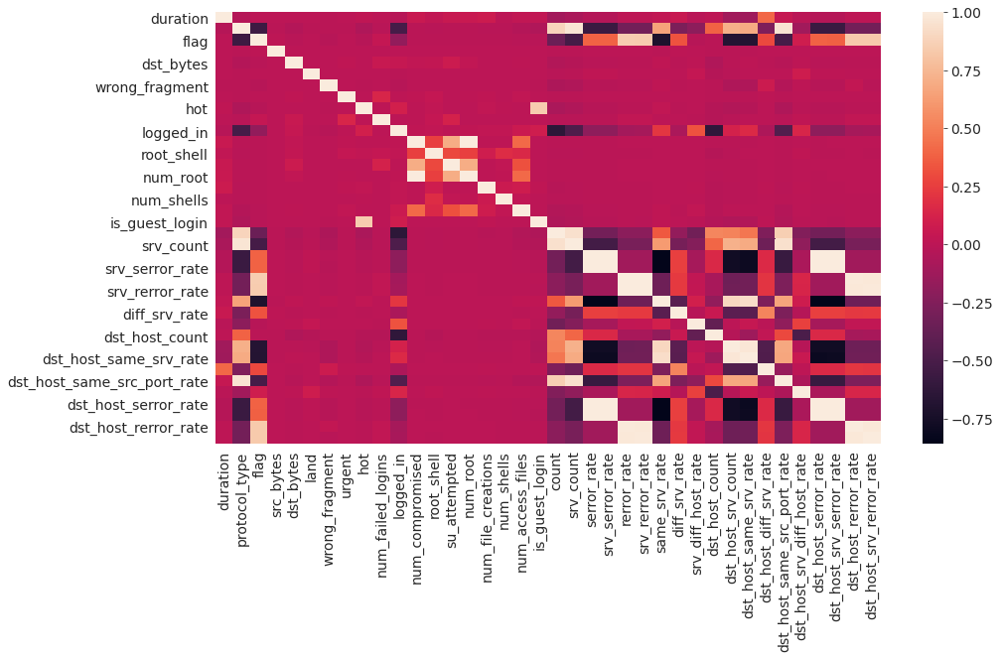

In [ ]:
# Find the correation of the different features
df_corr = train_df_uncleaned.corr()

fig = plt.subplots(figsize = (15, 8))

sns.heatmap(df_corr)
plt.show()

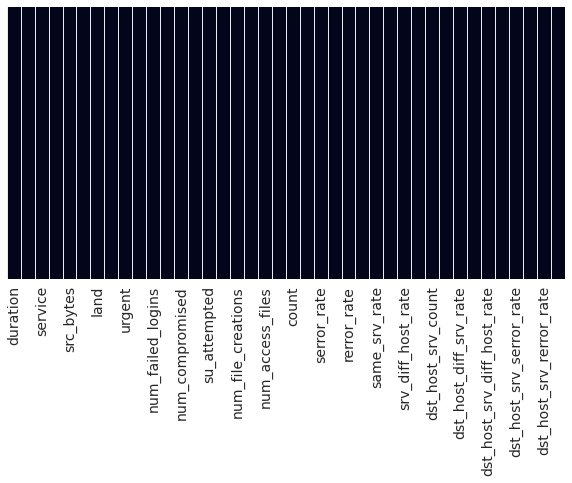

In [ ]:
# Checking for the nan values in the dataset
sns.heatmap(train_df_uncleaned.isnull(), yticklabels= False, cbar= False)

# Feature Mapping

In [ ]:
# We will see the importance of the features first
# service_map = {}
# For now i am dropping the columns from the dataset
train_df_uncleaned.drop('service', axis = 1, inplace = True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
print(train_df_uncleaned.shape)
train_df_uncleaned.head()

(494021, 39)


,duration,protocol_type,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_root,num_file_creations,num_shells,num_access_files,is_guest_login,count,srv_count,serror_rate,srv_serror_rate,rerror_rate,srv_rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,attack_type
0,0,0,0,181,5450,0,0,0,0,0,1,0,0,0,0,0,0,0,0,8,8,0.0,0.0,0.0,0.0,1.0,0.0,0.0,9,9,1.0,0.0,0.11,0.0,0.0,0.0,0.0,0.0,normal
1,0,0,0,239,486,0,0,0,0,0,1,0,0,0,0,0,0,0,0,8,8,0.0,0.0,0.0,0.0,1.0,0.0,0.0,19,19,1.0,0.0,0.05,0.0,0.0,0.0,0.0,0.0,normal
2,0,0,0,235,1337,0,0,0,0,0,1,0,0,0,0,0,0,0,0,8,8,0.0,0.0,0.0,0.0,1.0,0.0,0.0,29,29,1.0,0.0,0.03,0.0,0.0,0.0,0.0,0.0,normal
3,0,0,0,219,1337,0,0,0,0,0,1,0,0,0,0,0,0,0,0,6,6,0.0,0.0,0.0,0.0,1.0,0.0,0.0,39,39,1.0,0.0,0.03,0.0,0.0,0.0,0.0,0.0,normal
4,0,0,0,217,2032,0,0,0,0,0,1,0,0,0,0,0,0,0,0,6,6,0.0,0.0,0.0,0.0,1.0,0.0,0.0,49,49,1.0,0.0,0.02,0.0,0.0,0.0,0.0,0.0,normal


In [ ]:
# Droping of all the highly correlated columns so they dont impact the model 
train_df_uncleaned.drop('num_root', axis = 1, inplace= True)

train_df_uncleaned.drop('srv_serror_rate', axis = 1, inplace= True)

train_df_uncleaned.drop('srv_rerror_rate', axis = 1, inplace= True)

train_df_uncleaned.drop('dst_host_srv_serror_rate', axis = 1, inplace= True)

train_df_uncleaned.drop('dst_host_serror_rate', axis = 1, inplace= True)

train_df_uncleaned.drop('dst_host_rerror_rate', axis = 1, inplace= True)

train_df_uncleaned.drop('dst_host_srv_rerror_rate', axis = 1, inplace= True)

train_df_uncleaned.drop('dst_host_same_srv_rate', axis = 1, inplace= True)

/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4174: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
print(train_df_uncleaned.shape)
train_df_uncleaned.sample(10)

(494021, 31)


,duration,protocol_type,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,num_failed_logins,logged_in,num_compromised,root_shell,su_attempted,num_file_creations,num_shells,num_access_files,is_guest_login,count,srv_count,serror_rate,rerror_rate,same_srv_rate,diff_srv_rate,srv_diff_host_rate,dst_host_count,dst_host_srv_count,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,attack_type
327819,0,2,0,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,1.00,0.00,0.0,255,255,0.00,1.00,0.00,dos
147740,0,0,0,1180,342,0,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0.0,0.0,1.00,0.00,0.0,56,99,0.09,0.02,0.02,normal
490776,0,2,0,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,1.00,0.00,0.0,255,255,0.00,1.00,0.00,dos
357003,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,246,3,1.0,0.0,0.01,0.06,0.0,255,19,0.07,0.00,0.00,dos
185036,0,2,0,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,1.00,0.00,0.0,255,255,0.00,1.00,0.00,dos
251808,0,2,0,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,1.00,0.00,0.0,255,255,0.00,1.00,0.00,dos
228664,0,2,0,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,1.00,0.00,0.0,255,255,0.00,1.00,0.00,dos
59902,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,216,12,1.0,0.0,0.06,0.06,0.0,255,12,0.07,0.00,0.00,dos
252759,0,2,0,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,1.00,0.00,0.0,255,255,0.00,1.00,0.00,dos
49969,0,2,0,1032,0,0,0,0,0,0,0,0,0,0,0,0,0,0,511,511,0.0,0.0,1.00,0.00,0.0,255,255,0.00,1.00,0.00,dos


In [ ]:
# Spiliting the dataset
x = train_df_uncleaned.drop(['attack_type'], axis = 1)
y = train_df_uncleaned['attack_type']

print(x.shape, y.shape)

(494021, 30) (494021,)


In [ ]:
# Scaling the dataset
scale = MinMaxScaler(feature_range=(-1, 1))   
# range impact on the result (hyperparameter)
x = scale.fit_transform(x)

xtrain, xtest, ytrain, ytest = train_test_split(x, y, test_size = 0.35, random_state = 102)

In [ ]:
print(xtrain.shape, ytrain.shape)
print(xtest.shape, ytest.shape)

(321113, 30) (321113,)
(172908, 30) (172908,)


## Approch 1

Using simple neural network (ANN)

In [ ]:
# Setting up the hyperparameter
batch_size = 64
learning_rate = 0.01
optim = 'adam'
epochs = 10

In [ ]:
# simple model
# Creating the model (personal one)
def simple_model():
  model = Sequential()

  model.add(Dense(30, input_dim = 30, 
                  activation= 'LeakyReLU', 
                  kernel_initializer= 'he_uniform'))
  # (Add Dropout) model1.add(Dropout(0.5))

  model.add(Dense(10, activation= 'LeakyReLU',
                  kernel_initializer= 'he_uniform'))

  # As we have to possible outcome for any scenario
  model.add(Dense(5, activation = 'softmax'))

  model.compile(loss = 'categorical_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

  print(model.summary())

  return model

In [ ]:
model1 = KerasClassifier(build_fn= simple_model, epochs = epochs, batch_size = batch_size)

In [ ]:
history = model1.fit(xtrain, ytrain, verbose= 1)

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 30)                930       
_________________________________________________________________
dense_1 (Dense)              (None, 10)                310       
_________________________________________________________________
dense_2 (Dense)              (None, 5)                 55        
Total params: 1,295
Trainable params: 1,295
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/10
5018/5018 [==============================] - 24s 2ms/step - loss: 0.1226 - accuracy: 0.9597
Epoch 2/10
5018/5018 [==============================] - 11s 2ms/step - loss: 0.0248 - accuracy: 0.9931
Epoch 3/10
5018/5018 [==============================] - 11s 2ms/step - loss: 0.0183 - accuracy: 0.9942
Epoch 4/10
5018/5018 [==============================] - 11s 2ms/step -

In [ ]:
print(history.history.keys())

dict_keys(['loss', 'accuracy'])


In [ ]:
fig = px.line(y = history.history['accuracy'], 
              title = 'Accuracy of the model')
fig.show()

#plt.plot(history.history['accuracy'])
#plt.title('Accuracy of the model')
#plt.show()

In [ ]:
fig = px.line(y = history.history['loss'],
              title = 'Loss of the model')
fig.show()

#plt.plot(history.history['loss'])
#plt.title('Loss of the model')
#plt.show()

In [ ]:
# Taking prediction on training dataet
train_predict = model1.predict(xtrain)
train_acc = accuracy_score(ytrain, train_predict)
print('Accuracy of the model on training dataset: ', train_acc)

/usr/local/lib/python3.7/dist-packages/keras/engine/sequential.py:450: UserWarning:

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).



Accuracy of the model on training dataset:  0.9986609075309938


In [ ]:
# Taking prediction of the test dataset
ytest_predict = model1.predict(xtest)
test_acc = accuracy_score(ytest, ytest_predict)
print('Accuracy of the model on test dataset: ', test_acc)

/usr/local/lib/python3.7/dist-packages/keras/engine/sequential.py:450: UserWarning:

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).



Accuracy of the model on test dataset:  0.9984269091077336


In [ ]:
# Evaluation of the model on train set
simpleF1 = f1_score(ytrain, train_predict,average= 'weighted')
simplePrecision = precision_score(ytrain, train_predict, average = 'weighted')
simpleRecall = recall_score(ytrain, train_predict, average = 'weighted')
simpleAccuracy = accuracy_score(ytrain, train_predict)

print(f'F1 score: {simpleF1}')
print(f'Percision score: {simplePrecision}')
print(f'Recall score: {simpleRecall}')
print(f'Accuracy score: {simpleAccuracy}')

F1 score: 0.9986813504967963
Percision score: 0.9987510601935472
Recall score: 0.9986609075309938
Accuracy score: 0.9986609075309938


In [ ]:
# Evaluation of the model on test set
simpleF1 = f1_score(ytest, ytest_predict,average= 'micro')
simplePrecision = precision_score(ytest, ytest_predict, average = 'micro')
simpleRecall = recall_score(ytest, ytest_predict, average = 'micro')
simpleAccuracy = accuracy_score(ytest, ytest_predict)

print(f'F1 score: {simpleF1}')
print(f'Percision score: {simplePrecision}')
print(f'Recall score: {simpleRecall}')
print(f'Accuracy score: {simpleAccuracy}')

F1 score: 0.9984269091077336
Percision score: 0.9984269091077336
Recall score: 0.9984269091077336
Accuracy score: 0.9984269091077336


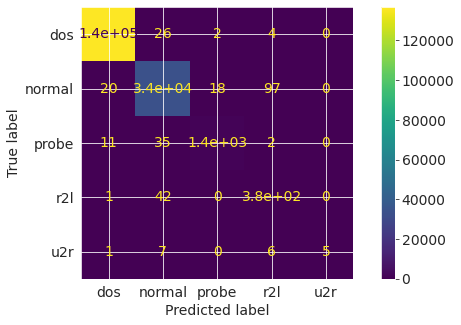

In [ ]:
matrix = confusion_matrix(ytest, ytest_predict, labels = model1.classes_)
matrixDisplay = ConfusionMatrixDisplay(matrix, display_labels= model1.classes_)
matrixDisplay.plot()

In [ ]:
# Saving the model
model1.model.save('model1.h5')

model_json = model1.model.to_json()

with open('model.json', 'w') as f:
  f.write(model_json)

## Approch 2

Using simple LSTM 

In [ ]:
train_df_uncleaned.shape

(494021, 31)

In [ ]:
x = train_df_uncleaned.drop(['attack_type'], axis = 1)
y = train_df_uncleaned['attack_type']
print(x.shape, y.shape)

(494021, 30) (494021,)


In [ ]:
# Converting the dataframe into array 
x_val = np.array(x.values)
print(x_val.shape)

(494021, 30)


In [ ]:
# Making the dataset 3D sutable for the LSTM
x_val = x_val.reshape(x_val.shape[0], x_val.shape[1], -1)
print(x_val.shape)
x_val

(494021, 30, 1)


array([[[0.  ],
        [0.  ],
        [0.  ],
        ...,
        [0.  ],
        [0.11],
        [0.  ]],

       [[0.  ],
        [0.  ],
        [0.  ],
        ...,
        [0.  ],
        [0.05],
        [0.  ]],

       [[0.  ],
        [0.  ],
        [0.  ],
        ...,
        [0.  ],
        [0.03],
        [0.  ]],

       ...,

       [[0.  ],
        [0.  ],
        [0.  ],
        ...,
        [0.  ],
        [0.06],
        [0.05]],

       [[0.  ],
        [0.  ],
        [0.  ],
        ...,
        [0.  ],
        [0.04],
        [0.05]],

       [[0.  ],
        [0.  ],
        [0.  ],
        ...,
        [0.  ],
        [0.17],
        [0.05]]])

In [ ]:
# split the data
xtrain, xtest, ytrain, ytest = train_test_split(x_val, y, 
                                                test_size = 0.35, 
                                                random_state = 42)
print(xtrain.shape, ytrain.shape, xtest.shape, ytest.shape)

(321113, 30, 1) (321113,) (172908, 30, 1) (172908,)


In [ ]:
# LSTM model2
def lstmModel():

  model = Sequential()

  model.add(LSTM(30, activation='LeakyReLU', input_shape = (30, 1),
                 kernel_initializer = 'he_uniform',  return_sequences = True))
  
  # model.add(BatchNormalization())
  # model.add(Dropout(0.3))

  model.add(LSTM(10, activation = 'LeakyReLU', 
                 return_sequences= False))

  # model.add(BatchNormalization())
  # model.add(Dropout(0.3))
  
  model.add(Dense(5, activation = 'softmax'))

  model.compile(loss= 'categorical_crossentropy', optimizer = 'adam', 
                metrics = ['accuracy'])

  print(model.summary())
  
  return model

In [ ]:
model2 = KerasClassifier(build_fn = lstmModel, epochs = 5, 
                         batch_size = batch_size)

In [ ]:
history = model2.fit(xtrain, ytrain)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 30, 30)            3840      
_________________________________________________________________
lstm_1 (LSTM)                (None, 10)                1640      
_________________________________________________________________
dense_3 (Dense)              (None, 5)                 55        
Total params: 5,535
Trainable params: 5,535
Non-trainable params: 0
_________________________________________________________________
None
Epoch 1/5
5018/5018 [==============================] - 457s 89ms/step - loss: 8711.3184 - accuracy: 0.6215
Epoch 2/5
5018/5018 [==============================] - 445s 89ms/step - loss: 66.7572 - accuracy: 0.7338
Epoch 3/5
5018/5018 [==============================] - 444s 89ms/step - loss: 27.2702 - accuracy: 0.7994
Epoch 4/5
5018/5018 [==============================] - 445s 

In [ ]:
fig = px.line(y = history.history['accuracy'], 
              title = 'Accuracy of the model')
fig.show()

In [ ]:
fig = px.line(y = history.history['loss'],
              title = 'Loss of the model')
fig.show()

In [ ]:
# Taking prediction on training dataet
train_predict = model2.predict(xtrain)
train_acc = accuracy_score(ytrain, train_predict)
print('Accuracy of the model on training dataset: ', train_acc)

/usr/local/lib/python3.7/dist-packages/keras/engine/sequential.py:450: UserWarning:

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).



Accuracy of the model on training dataset:  0.703568525721475


In [ ]:
# Taking prediction of the test dataset
ytest_predict = model2.predict(xtest)
test_acc = accuracy_score(ytest, ytest_predict)
print('Accuracy of the model on test dataset: ', test_acc)

/usr/local/lib/python3.7/dist-packages/keras/engine/sequential.py:450: UserWarning:

`model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).



Accuracy of the model on test dataset:  0.7011647812709649


In [ ]:
# Evaluation of the model on train set
lstmF1 = f1_score(ytrain, train_predict,average= 'weighted')
lstmPrecision = precision_score(ytrain, train_predict, average = 'weighted')
lstmRecall = recall_score(ytrain, train_predict, average = 'weighted')
lstmAccuracy = accuracy_score(ytrain, train_predict)

print(f'F1 score: {lstmF1}')
print(f'Percision score: {lstmPrecision}')
print(f'Recall score: {lstmRecall}')
print(f'Accuracy score: {lstmAccuracy}')

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



F1 score: 0.7216592897257583
Percision score: 0.7417202738301957
Recall score: 0.703568525721475
Accuracy score: 0.703568525721475


In [ ]:
# Evaluation of the model on test set
lstmF1 = f1_score(ytest, ytest_predict,average= 'micro')
lstmPrecision = precision_score(ytest, ytest_predict, average = 'micro')
lstmRecall = recall_score(ytest, ytest_predict, average = 'micro')
lstmAccuracy = accuracy_score(ytest, ytest_predict)

print(f'F1 score: {lstmF1}')
print(f'Percision score: {lstmPrecision}')
print(f'Recall score: {lstmRecall}')
print(f'Accuracy score: {lstmAccuracy}')

F1 score: 0.7011647812709649
Percision score: 0.7011647812709649
Recall score: 0.7011647812709649
Accuracy score: 0.7011647812709649


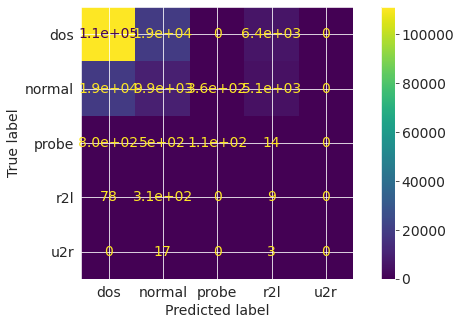

In [ ]:
matrix = confusion_matrix(ytest, ytest_predict, labels = model1.classes_)
matrixDisplay = ConfusionMatrixDisplay(matrix, display_labels= model1.classes_)
matrixDisplay.plot()

In [ ]:
# Saving the model
model2.model.save('model2.h5')

model2_json = model2.model.to_json()

with open('model2.json', 'w') as f:
  f.write(model2_json)

In [ ]:
jovian.commit(project = project_name)

[jovian] Detected Colab notebook...
[jovian] Please enter your API key ( from https://jovian.ai/ ):
API KEY: ··········
[jovian] Uploading colab notebook to Jovian...
Committed successfully! https://jovian.ai/lakshaygola/anomaly-detection


'https://jovian.ai/lakshaygola/anomaly-detection'